Laboratorium polegało na zapoznaniu się z wybranymi algorytmamui demozaikingu i zbadania ich wpływu na jakość wynikowego obrazu RGB. W tym konkretnym przypadku rozważane były dwa algorytmy: interpolacji bilinearnej oraz algorytm Malvara.
Po zaimplementowaniu ich, należało wykonać eksperyment porównując obrazy oryginalne z zdekodowanymi oraz wyciągnąć wnioski.

Importy i definicje stałych:

In [1]:
import numpy as np
from matplotlib import pyplot as plt

IMAGES_DIR = './images'
CFA_FILTER = np.array([['G', 'R'], ['B', 'G']])

Funkcja pomocnicza wykorzystywana w kodowaniu obrazu. Mapuje ona oznaczenie składowej RGB na indeks koloru.

In [2]:
def map_cfa_filter_val_to_rgb_index(value: str) -> int:
    if value == 'G':
        return 1

    if value == 'R':
        return 0

    return 2

Funkcja kodująca obraz według rodzaju filtru określonego w stałej `CFA_FILTER`.

In [3]:
def code_image(image: np.array) -> np.array:
    coded_image = np.empty((image.shape[0], image.shape[1]))

    for row_iter, row in enumerate(image):
        cfa_row = row_iter % CFA_FILTER.shape[0]

        for color_iter, color in enumerate(row):
            cfa_column = color_iter % CFA_FILTER.shape[1]

            color_to_select = map_cfa_filter_val_to_rgb_index(CFA_FILTER[cfa_row, cfa_column])
            selected_color = color[color_to_select]
            coded_image[row_iter, color_iter] = selected_color

    return coded_image

Funkcja dekodująca zakodowany obraz Bayera z wykorzystaniem algorytmu interpolacji bilinearnej.

In [4]:
def decode_by_interpolation(coded_image: np.array) -> np.array:
    decoded = np.zeros((*coded_image.shape, 3))
    pixels_to_skip_on_borders = 1  # skip 1 pixel on borders to make algorithm easier

    for r in range(pixels_to_skip_on_borders, coded_image.shape[0] - pixels_to_skip_on_borders):
        row = coded_image[r]

        for c in range(pixels_to_skip_on_borders, coded_image.shape[1] - pixels_to_skip_on_borders):
            encoded_value = row[c]
            actual_rgb_component = CFA_FILTER[r % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]]
            decoded_color = np.zeros(3)  # (R, G, B)

            if actual_rgb_component == 'R':
                green = np.mean([coded_image[r - 1, c], coded_image[r, c - 1], coded_image[r, c + 1], coded_image[r + 1, c]])
                blue = np.mean([coded_image[r - 1, c - 1], coded_image[r - 1, c + 1], coded_image[r + 1, c - 1], coded_image[r + 1, c + 1]])

                decoded_color = np.array([encoded_value, green, blue])
            elif actual_rgb_component == 'B':
                red = np.mean([coded_image[r - 1, c - 1], coded_image[r - 1, c + 1], coded_image[r + 1, c - 1], coded_image[r + 1, c + 1]])
                green = np.mean([coded_image[r - 1, c], coded_image[r, c - 1], coded_image[r, c + 1], coded_image[r + 1, c]])

                decoded_color = np.array([red, green, encoded_value])
            else:
                if CFA_FILTER[r % CFA_FILTER.shape[0], (c + 1) % CFA_FILTER.shape[1]] == 'R' and CFA_FILTER[(r + 1) % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]] == 'B':
                    red = np.mean([coded_image[r, c - 1], coded_image[r, c + 1]])
                    blue = np.mean([coded_image[r - 1, c], coded_image[r + 1, c]])

                    decoded_color = np.array([red, encoded_value, blue])
                elif CFA_FILTER[(r + 1) % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]] == 'R' and CFA_FILTER[r % CFA_FILTER.shape[0], (c + 1) % CFA_FILTER.shape[1]] == 'B':
                    red = np.mean([coded_image[r - 1, c], coded_image[r + 1, c]])
                    blue = np.mean([coded_image[r, c - 1], coded_image[r, c + 1]])

                    decoded_color = np.array([red, encoded_value, blue])

            decoded[r, c] = decoded_color

    decoded = decoded / np.amax(decoded)
    decoded = np.clip(decoded, 0, 1)

    return decoded

Funkcja dekodująca zakodowany obraz Bayera z wykorzystaniem algorytmu interpolacji wysokiej jakości, czyli z użyciem algorytmu Malvara.

In [5]:
def decode_by_malvar(coded_image: np.array) -> np.array:
    decoded = np.zeros((*coded_image.shape, 3))
    pixels_to_skip_on_borders = 2  # skip 2 pixel on borders to make algorithm easier

    for r in range(pixels_to_skip_on_borders, coded_image.shape[0] - pixels_to_skip_on_borders):
        row = coded_image[r]

        for c in range(pixels_to_skip_on_borders, coded_image.shape[1] - pixels_to_skip_on_borders):
            encoded_value = row[c]
            decoded_color = np.zeros(3)  # (R, G, B)
            actual_rgb_component = CFA_FILTER[r % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]]

            if actual_rgb_component == 'R':
                green = (2 * coded_image[r - 1, c] + 2 * coded_image[r, c - 1] + 2 * coded_image[r, c + 1] + 2 * coded_image[r + 1, c] + 4 * encoded_value + -1 * coded_image[r - 2, c] + -1 * coded_image[r, c - 2] + -1 * coded_image[r, c + 2] + -1 * coded_image[r + 2, c]) / 8
                blue = (2 * coded_image[r - 1, c - 1] + 2 * coded_image[r - 1, c + 1] + 2 * coded_image[r + 1, c - 1] + 2 * coded_image[r + 1, c + 1] + 6 * encoded_value + -3/2 * coded_image[r - 2, c] + -3/2 * coded_image[r, c - 2] + -3/2 * coded_image[r, c + 2] + -3/2 * coded_image[r + 2, c]) / 8

                decoded_color = np.array([encoded_value, green, blue])
            elif actual_rgb_component == 'B':
                green = (2 * coded_image[r - 1, c] + 2 * coded_image[r, c - 1] + 2 * coded_image[r, c + 1] + 2 * coded_image[r + 1, c] + 4 * encoded_value + -1 * coded_image[r - 2, c] + -1 * coded_image[r, c - 2] + -1 * coded_image[r, c + 2] + -1 * coded_image[r + 2, c]) / 8
                red = (2 * coded_image[r - 1, c - 1] + 2 * coded_image[r - 1, c + 1] + 2 * coded_image[r + 1, c - 1] + 2 * coded_image[r + 1, c + 1] + 6 * encoded_value + -3/2 * coded_image[r - 2, c] + -3/2 * coded_image[r, c - 2] + -3/2 * coded_image[r, c + 2] + -3/2 * coded_image[r + 2, c]) / 8

                decoded_color = np.array([red, green, encoded_value])
            else:
                if CFA_FILTER[r % CFA_FILTER.shape[0], (c + 1) % CFA_FILTER.shape[1]] == 'R' and CFA_FILTER[(r + 1) % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]] == 'B':
                    red = (4 * coded_image[r, c - 1] + 4 * coded_image[r, c + 1] + 5 * encoded_value + 1/2 * coded_image[r - 2, c] + -1 * coded_image[r - 1, c - 1] + -1 * coded_image[r - 1, c + 1] + -1 * coded_image[r, c - 2] + -1 * coded_image[r, c + 2] + -1 * coded_image[r + 1, c - 1] + -1 * coded_image[r + 1, c + 1] + 1/2 * coded_image[r + 2, c]) / 8
                    blue = (4 * coded_image[r - 1, c] + 4 * coded_image[r + 1, c] + 5 * encoded_value + -1 * coded_image[r - 2, c] + -1 * coded_image[r - 1, c - 1] + -1 * coded_image[r - 1, c + 1] + 1/2 * coded_image[r, c - 2] + 1/2 * coded_image[r, c + 2] + -1 * coded_image[r + 1, c - 1] + -1 * coded_image[r + 1, c + 1] + -1 * coded_image[r + 2, c]) / 8

                    decoded_color = np.array([red, encoded_value, blue])
                elif CFA_FILTER[(r + 1) % CFA_FILTER.shape[0], c % CFA_FILTER.shape[1]] == 'R' and CFA_FILTER[r % CFA_FILTER.shape[0], (c + 1) % CFA_FILTER.shape[1]] == 'B':
                    blue = (4 * coded_image[r, c - 1] + 4 * coded_image[r, c + 1] + 5 * encoded_value + 1/2 * coded_image[r - 2, c] + -1 * coded_image[r - 1, c - 1] + -1 * coded_image[r - 1, c + 1] + -1 * coded_image[r, c - 2] + -1 * coded_image[r, c + 2] + -1 * coded_image[r + 1, c - 1] + -1 * coded_image[r + 1, c + 1] + 1/2 * coded_image[r + 2, c]) / 8
                    red = (4 * coded_image[r - 1, c] + 4 * coded_image[r + 1, c] + 5 * encoded_value + -1 * coded_image[r - 2, c] + -1 * coded_image[r - 1, c - 1] + -1 * coded_image[r - 1, c + 1] + 1/2 * coded_image[r, c - 2] + 1/2 * coded_image[r, c + 2] + -1 * coded_image[r + 1, c - 1] + -1 * coded_image[r + 1, c + 1] + -1 * coded_image[r + 2, c]) / 8

                    decoded_color = np.array([red, encoded_value, blue])

            decoded[r, c] = decoded_color

    decoded = decoded / np.amax(decoded)
    decoded = np.clip(decoded, 0, 1)

    return decoded

Funkcja wyliczjąca błąd średniokwadratowy pomiędzy dwoma obrazami.

In [6]:
def mse(image1: np.array, image2: np.array) -> float:
    error = 0

    for r in range(0, image1.shape[0]):
        for c in range(0, image2.shape[0]):
            error += np.sum(np.power(image1[r, c] - image2[r, c], 2))

    return error / (image1.shape[0] * image1.shape[1])

Funkcja odpowiedzialna za wykonanie eksperymentu.

In [7]:
def experiment(filepath: str, save: bool = False) -> None:
    filename = filepath.split('/')[-1].split('.')[0]

    image = plt.imread(filepath)
    coded_image = code_image(image)

    if not save:
        print('Original image')
        plt.figure(figsize=(20, 10))
        plt.imshow(image)
        plt.show()

        print('Coded image')
        plt.figure(figsize=(20, 10))
        plt.imshow(coded_image)
        plt.show()
    else:
        plt.figure()
        plt.imsave(f'{IMAGES_DIR}/coded_image_{filename}.png', coded_image)

    decoded_image_bilinear = decode_by_interpolation(coded_image)
    mse_error = mse(image, decoded_image_bilinear)
    print(f'Mean squared error for bilinear interpolation: {mse_error}')

    if not save:
        print('Original image')
        plt.figure(figsize=(20, 10))
        plt.imshow(image)
        plt.show()

        print('Decoded image by bilinear interpolation')
        plt.figure(figsize=(20, 10))
        plt.imshow(decoded_image_bilinear)
        plt.show()
    else:
        plt.figure()
        plt.imsave(f'{IMAGES_DIR}/demosaiced_bilinear_{filename}.png', decoded_image_bilinear)

    plt.figure(figsize=(20, 10))
    if not save:
        print('Original image in zoom')
        plt.figure(figsize=(20, 10))
        plt.imshow(image[200:600, 200:600])
        plt.show()

        print('Decoded image by bilinear interpolation in zoom')
        plt.figure(figsize=(20, 10))
        plt.imshow(decoded_image_bilinear[200:600, 200:600])
        plt.show()
    else:
        plt.figure()
        plt.imsave(f'{IMAGES_DIR}/demosaiced_bilinear_zoom_{filename}.png', decoded_image_bilinear[200:600, 200:600])

    decoded_image_malvar = decode_by_malvar(coded_image)
    mse_error = mse(image, decoded_image_malvar)
    print(f'Mean squared error for malvar interpolation: {mse_error}')

    if not save:
        print('Original image')
        plt.figure(figsize=(20, 10))
        plt.imshow(image)
        plt.show()

        print('Decoded image by malvar interpolation')
        plt.figure(figsize=(20, 10))
        plt.imshow(decoded_image_malvar)
        plt.show()
    else:
        plt.figure()
        plt.imsave(f'{IMAGES_DIR}/demosaiced_malvar_{filename}.png', decoded_image_malvar)

    if not save:
        print('Original image in zoom')
        plt.figure(figsize=(20, 10))
        plt.imshow(image[200:600, 200:600])
        plt.show()
        
        print('Decoded image by malvar interpolation in zoom')
        plt.figure(figsize=(20, 10))
        plt.imshow(decoded_image_malvar[200:600, 200:600])
        plt.show()
    else:
        plt.figure()
        plt.imsave(f'{IMAGES_DIR}/demosaiced_malvar_zoom_{filename}.png', decoded_image_malvar[200:600, 200:600])

Original image


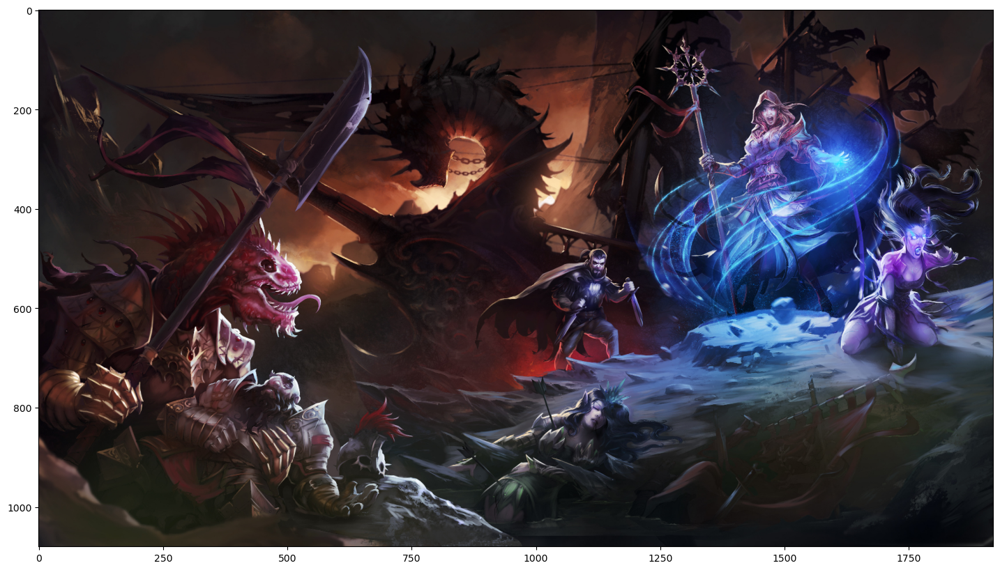

Coded image


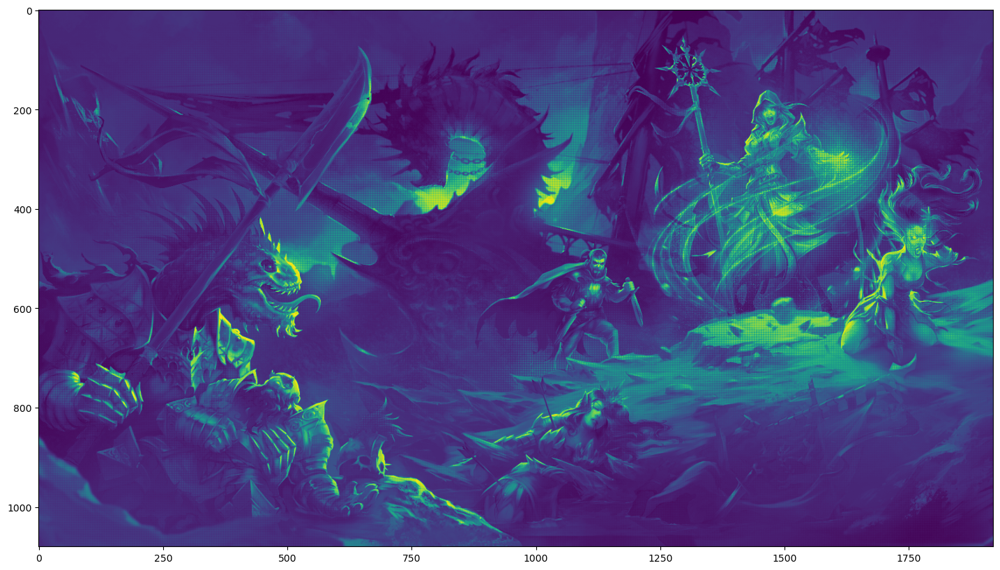

Mean squared error for bilinear interpolation: 5253.81125610869
Original image


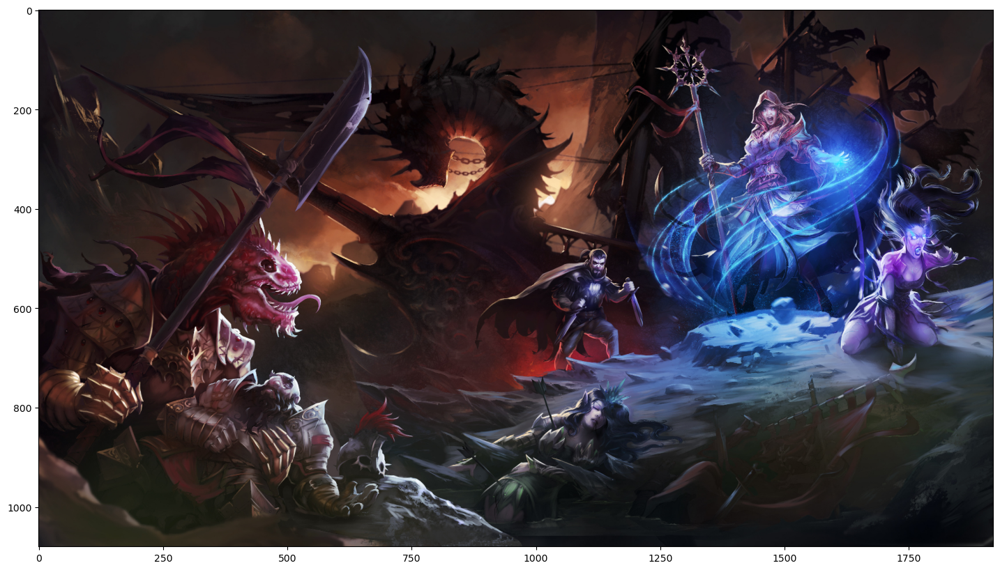

Decoded image by bilinear interpolation


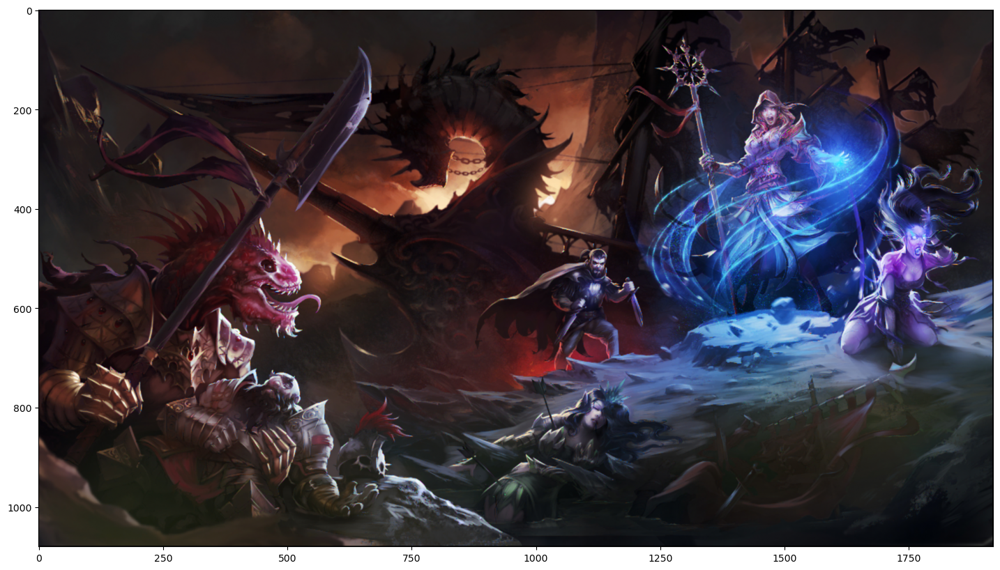

Original image in zoom


<Figure size 2000x1000 with 0 Axes>

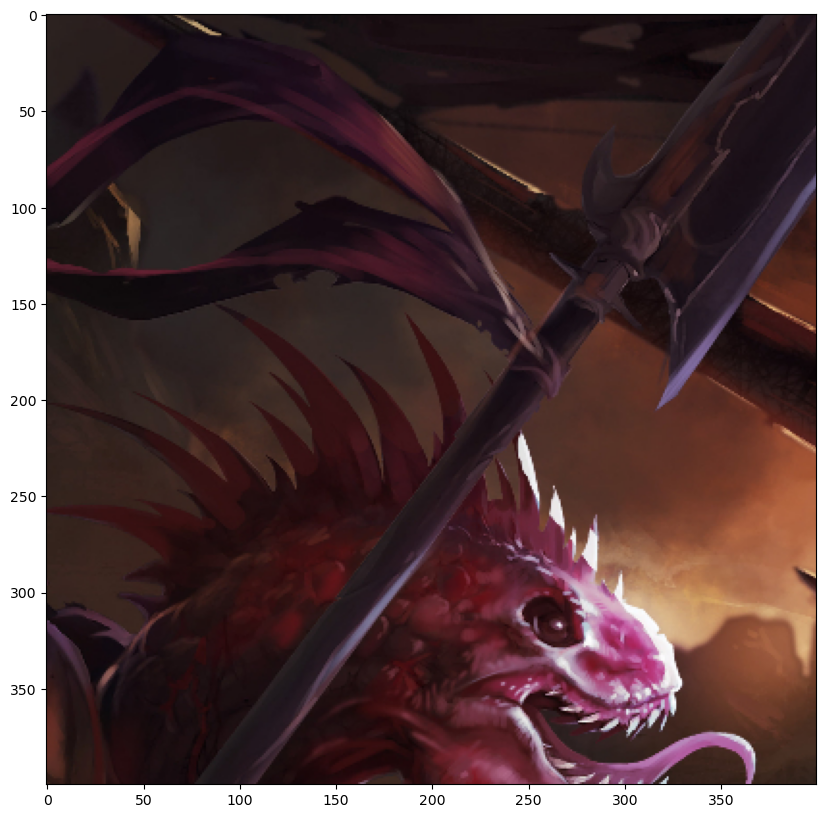

Decoded image by bilinear interpolation in zoom


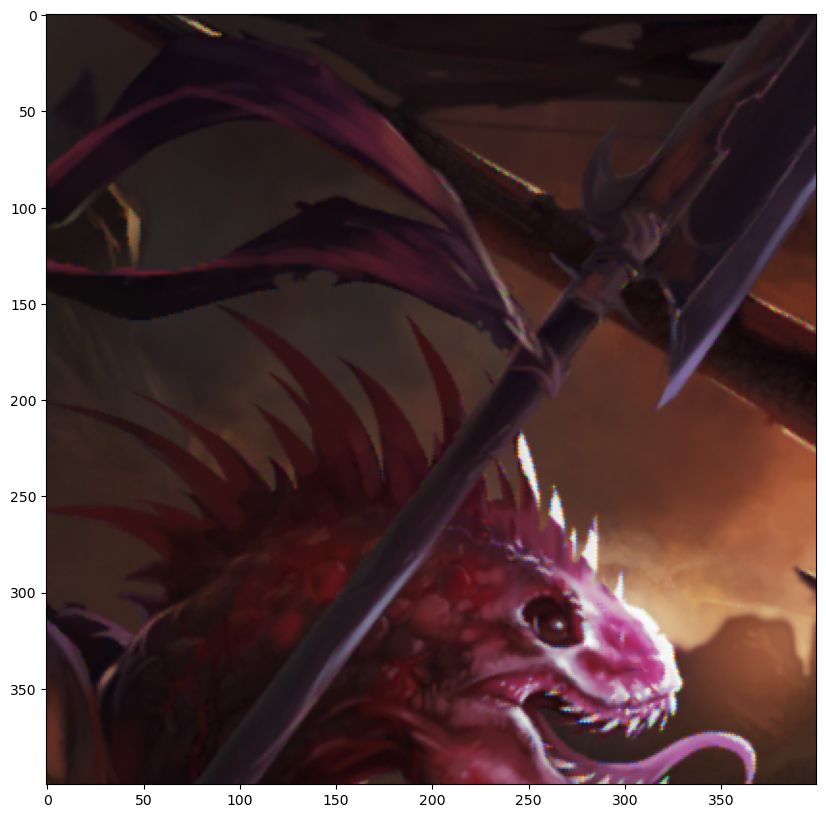

Mean squared error for malvar interpolation: 5262.070003895615
Original image


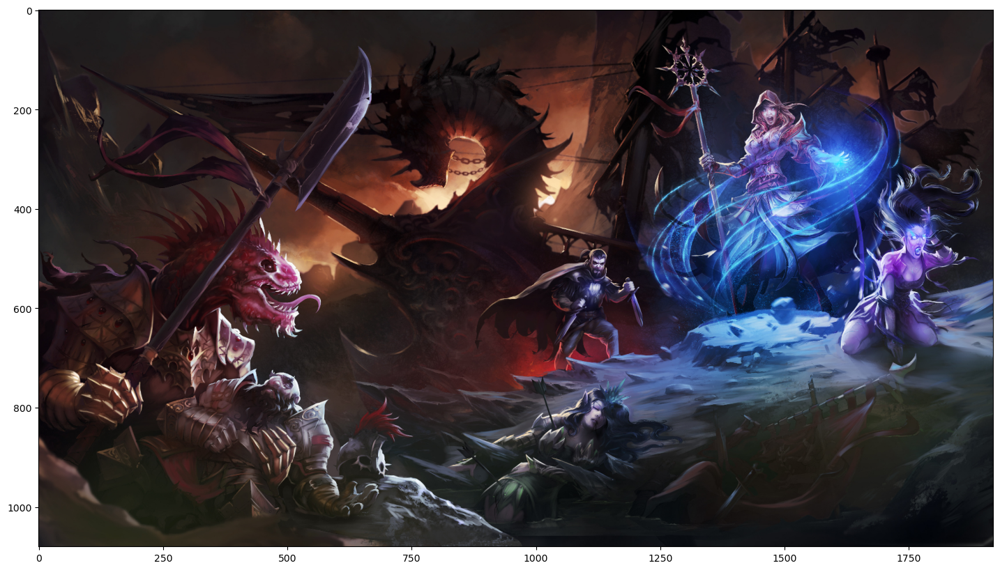

Decoded image by malvar interpolation


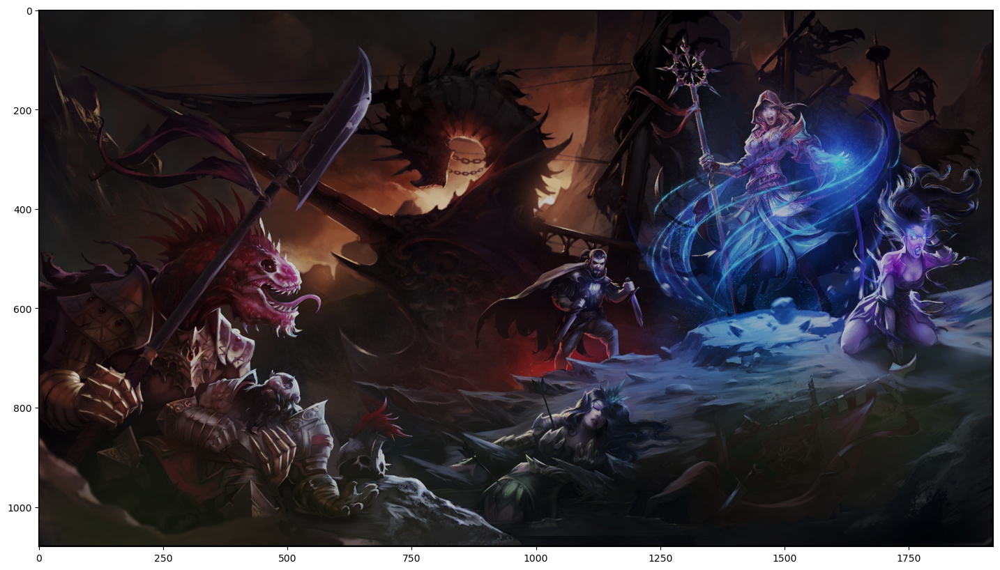

Original image in zoom


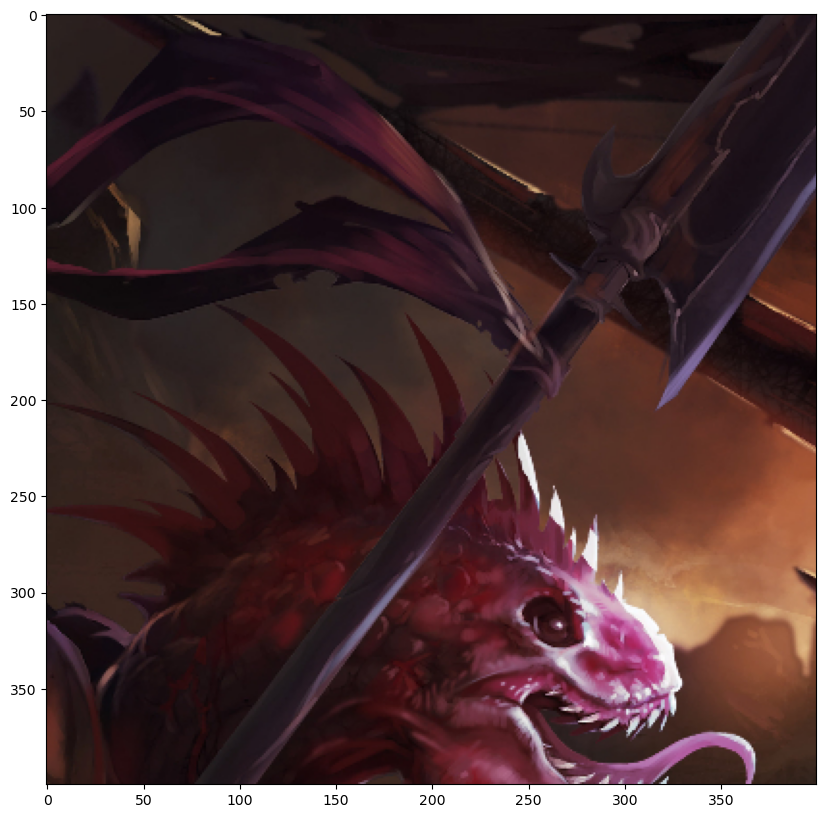

Decoded image by malvar interpolation in zoom


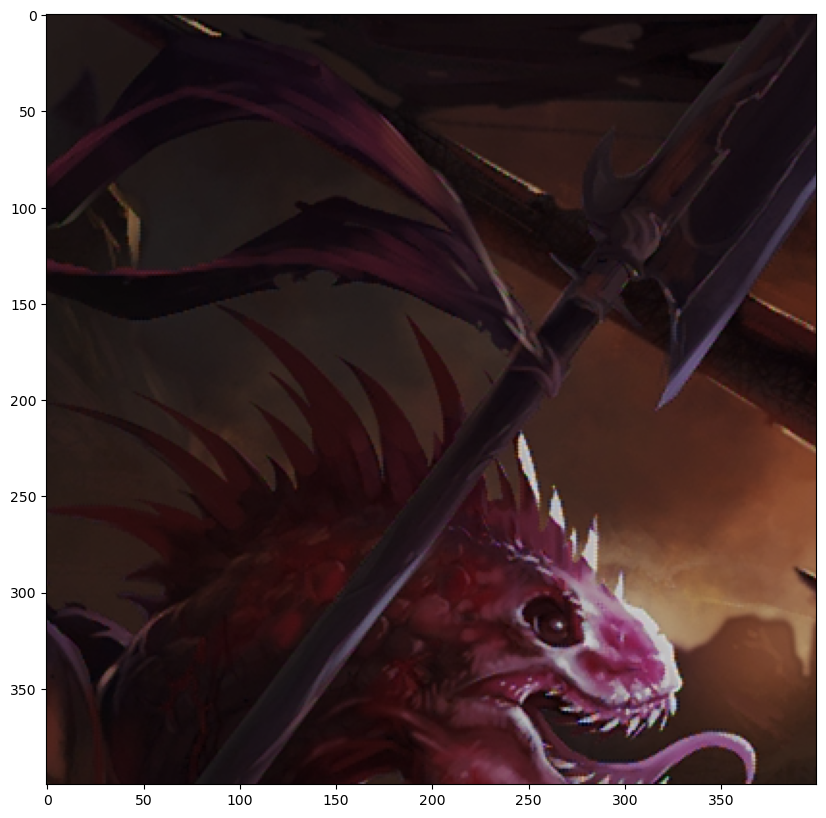

Original image


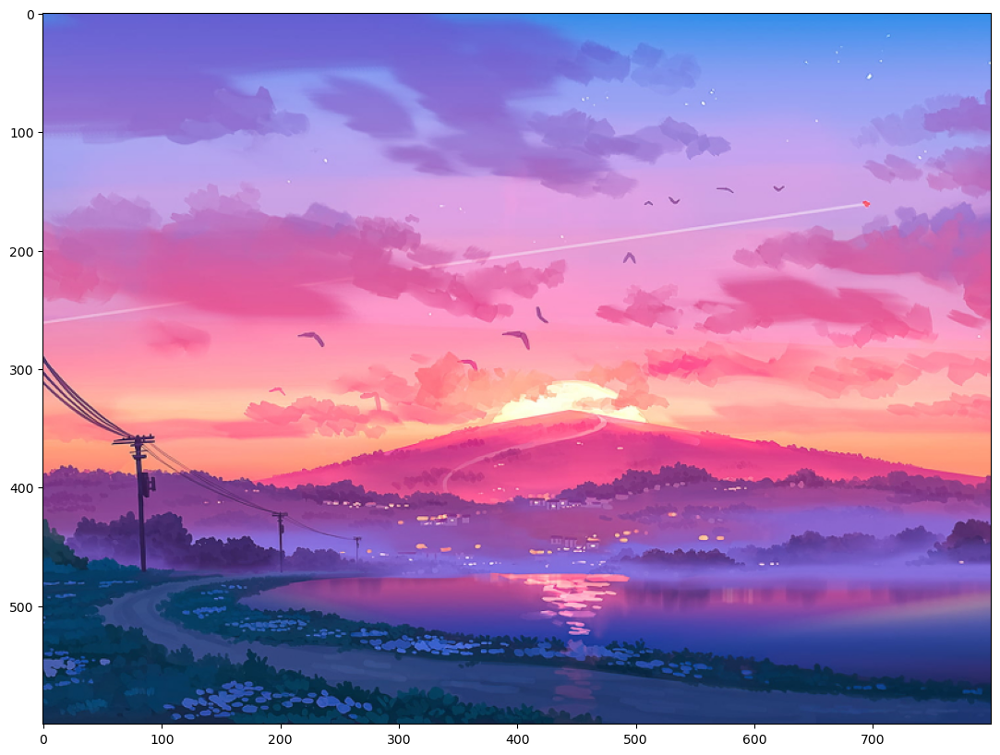

Coded image


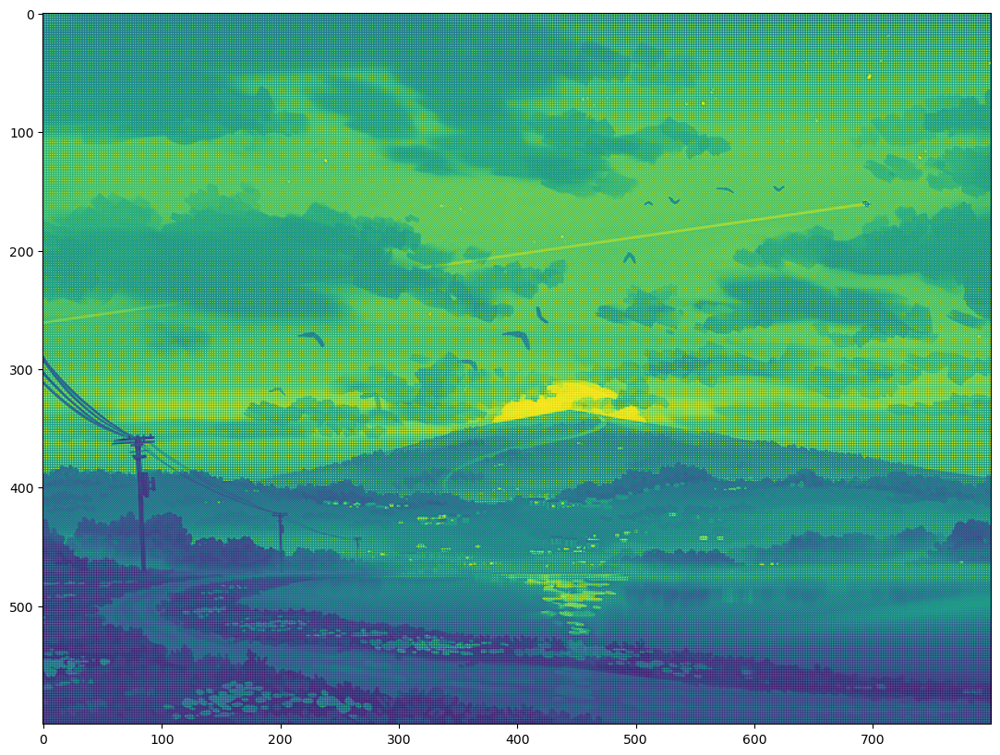

Mean squared error for bilinear interpolation: 58116.34631620551
Original image


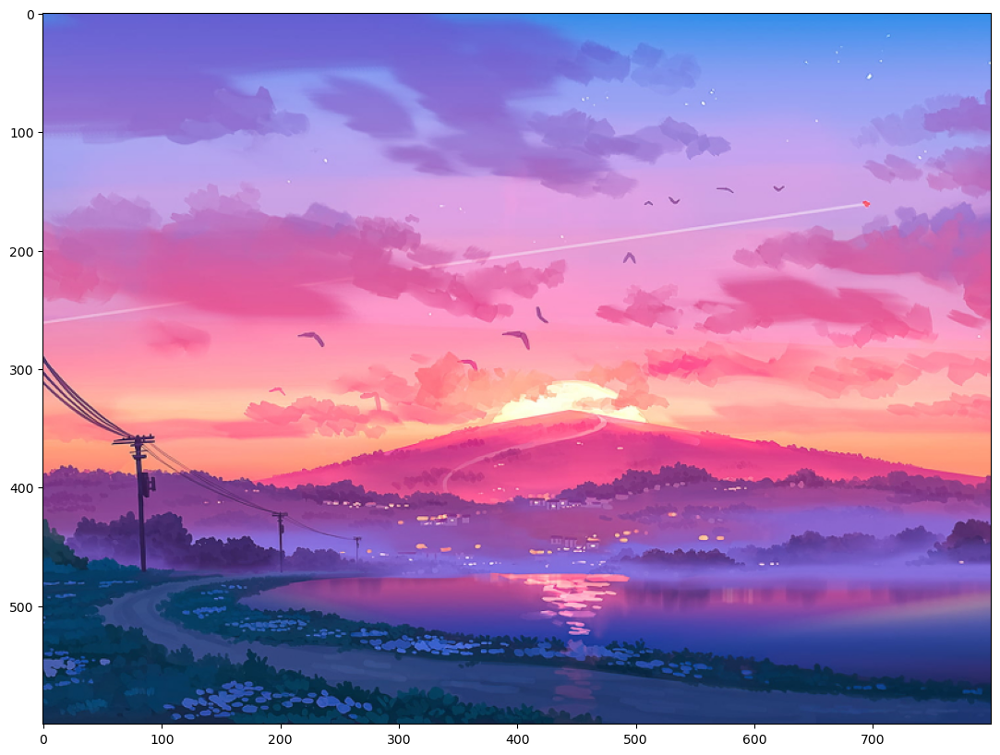

Decoded image by bilinear interpolation


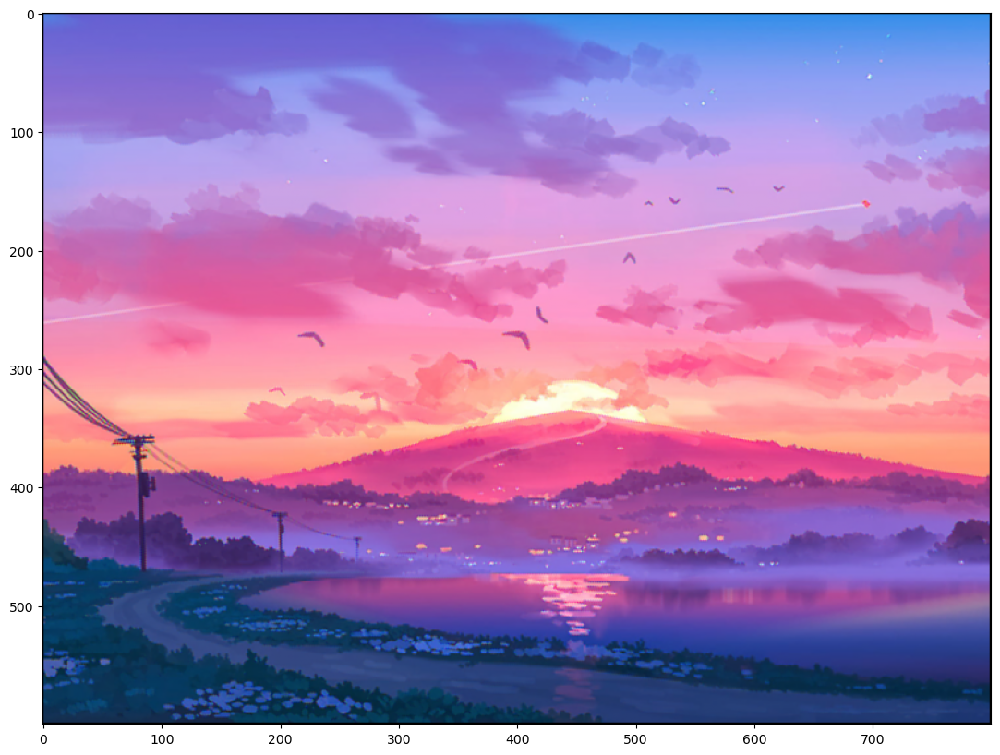

Original image in zoom


<Figure size 2000x1000 with 0 Axes>

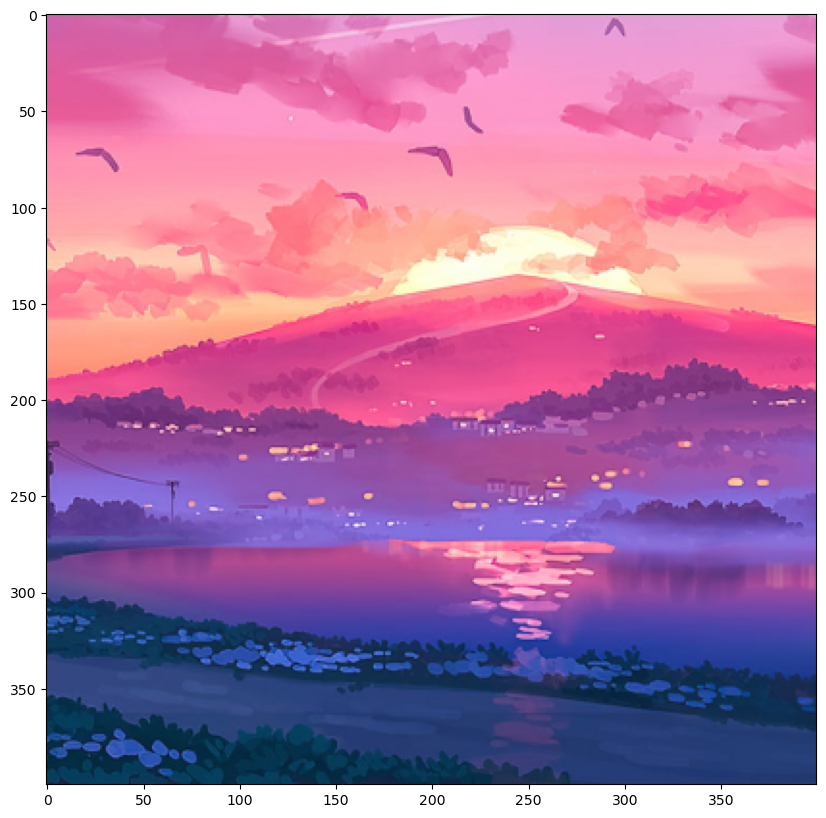

Decoded image by bilinear interpolation in zoom


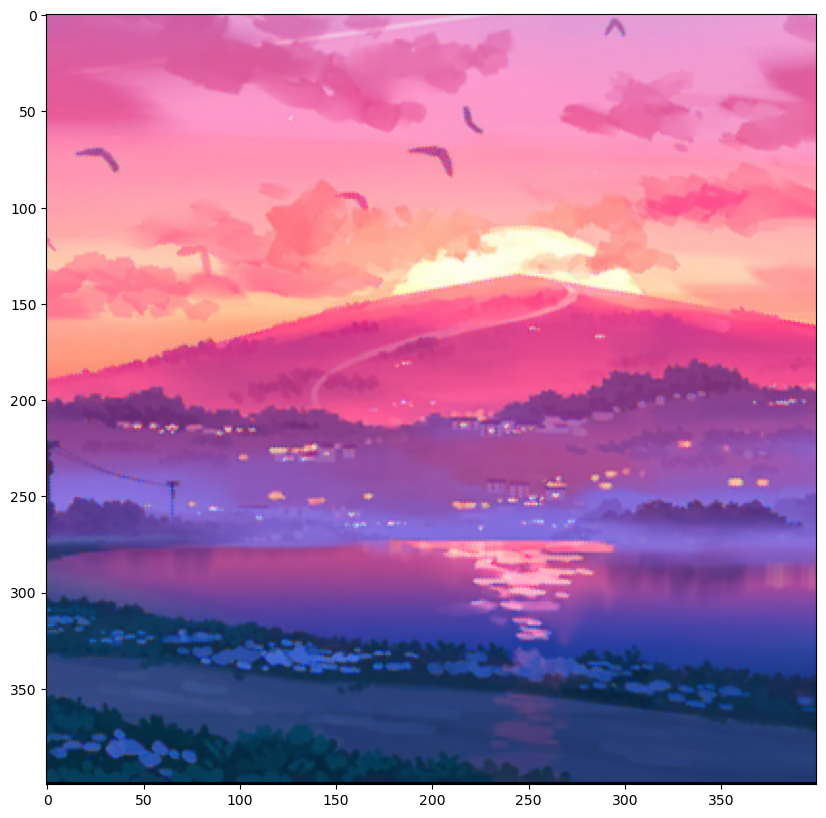

Mean squared error for malvar interpolation: 58215.9090521347
Original image


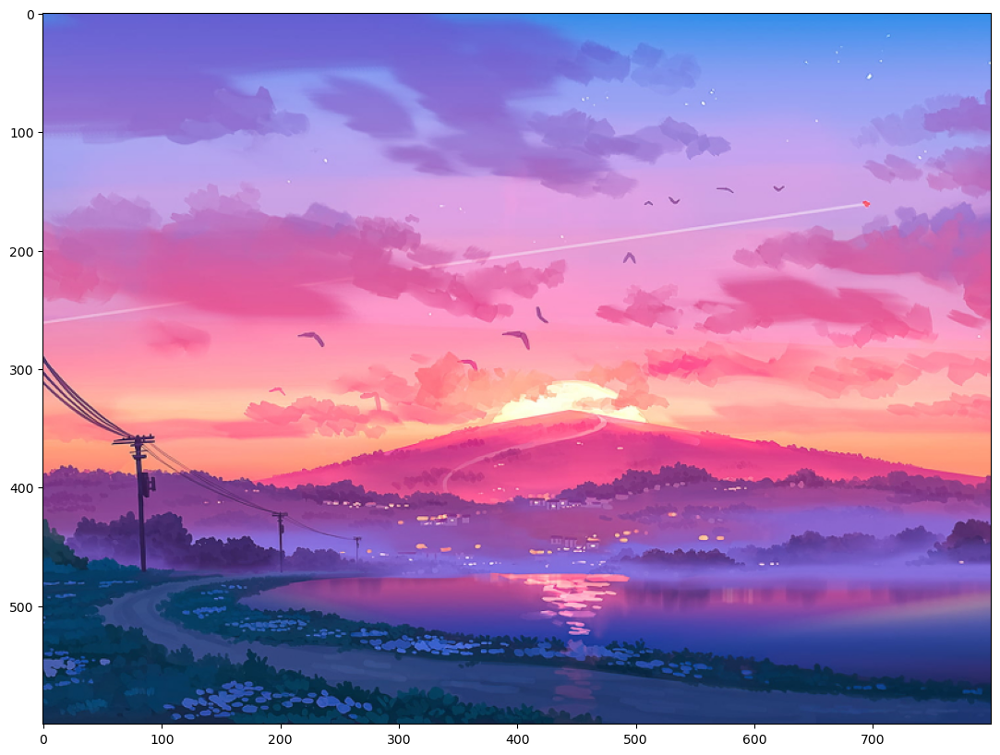

Decoded image by malvar interpolation


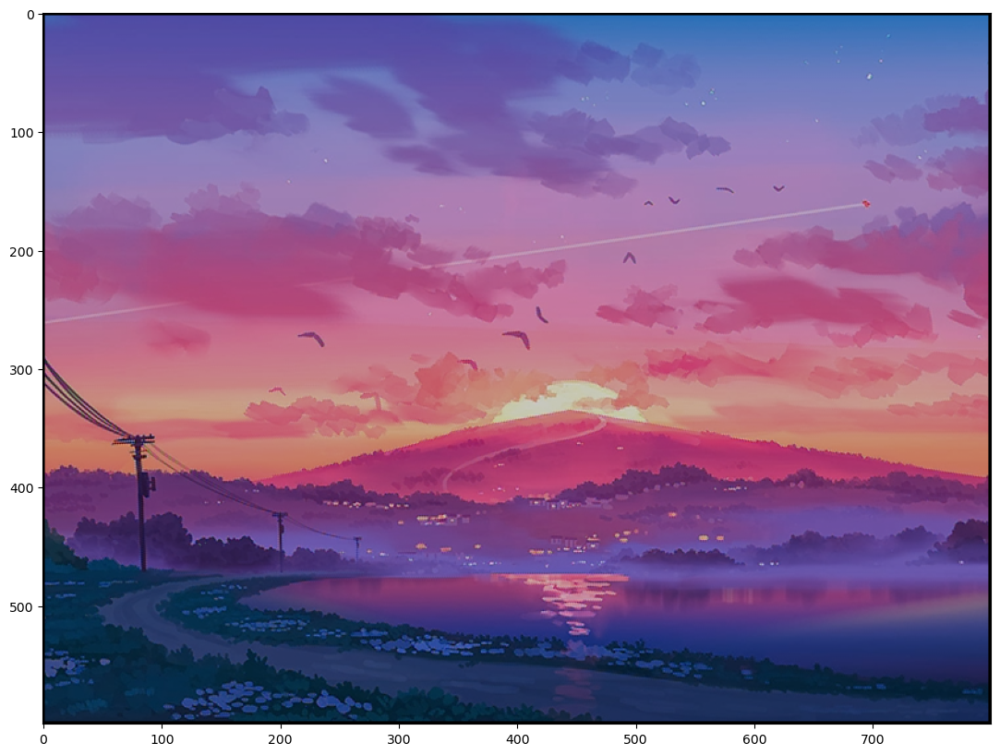

Original image in zoom


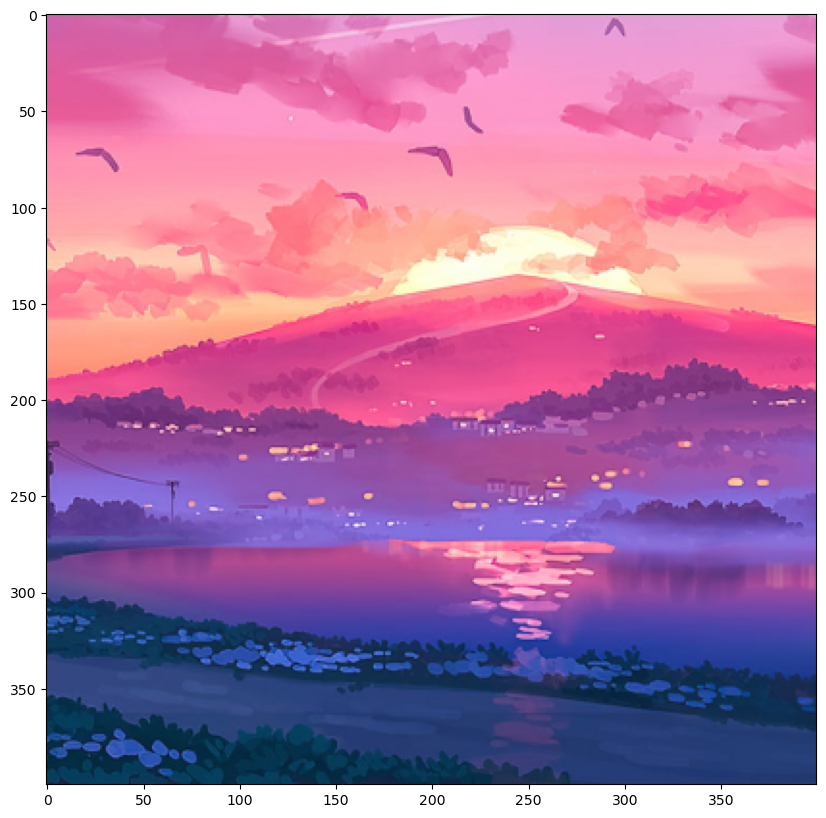

Decoded image by malvar interpolation in zoom


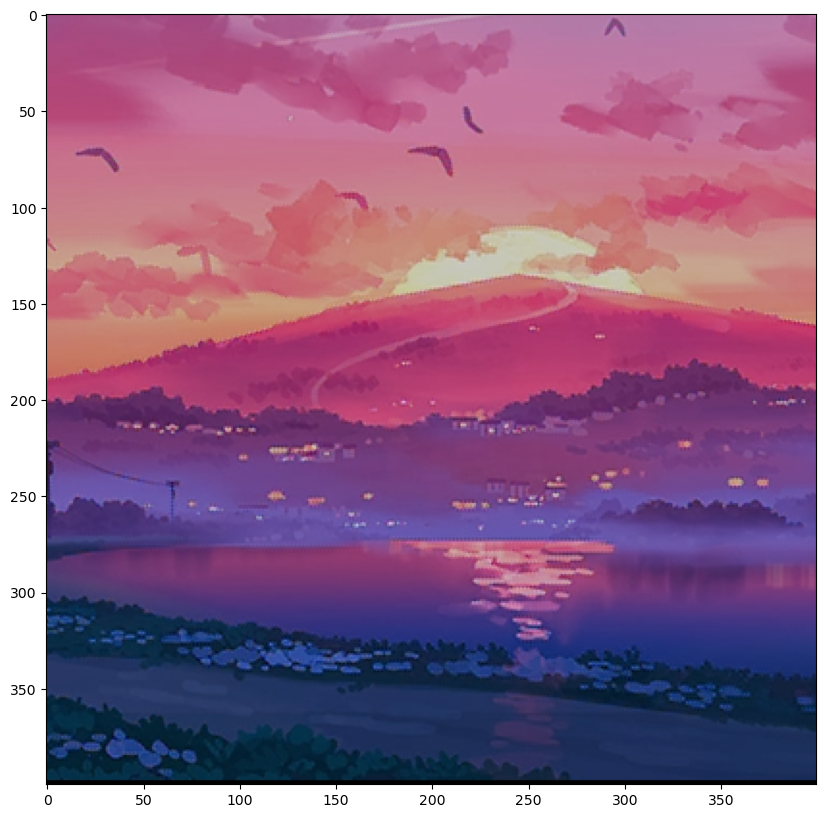

Original image


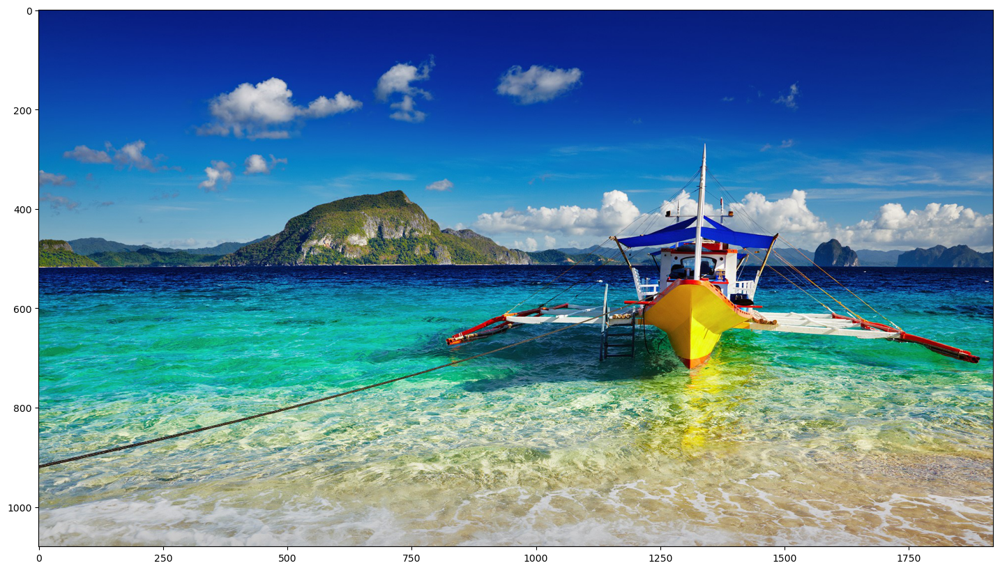

Coded image


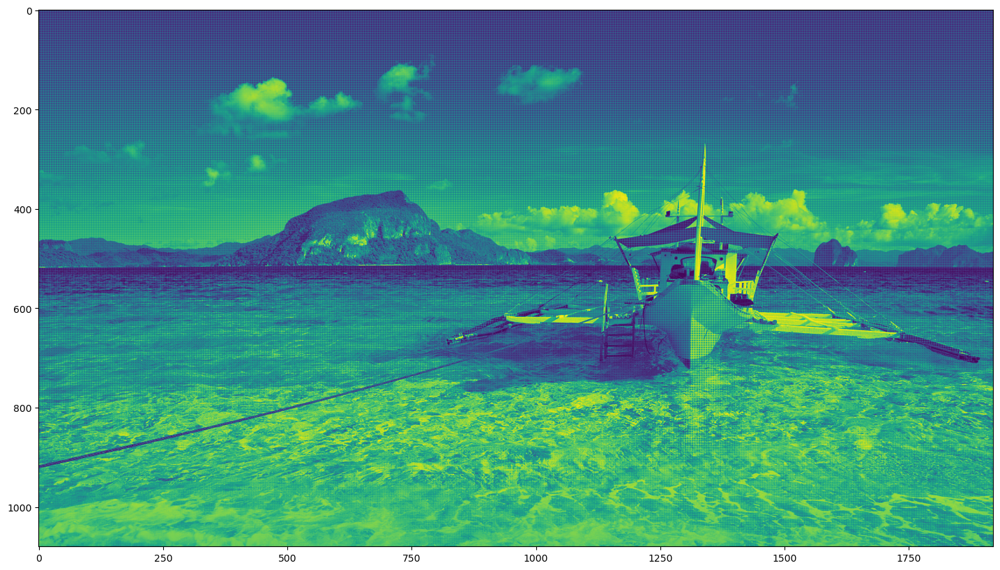

Mean squared error for bilinear interpolation: 31949.576390123228
Original image


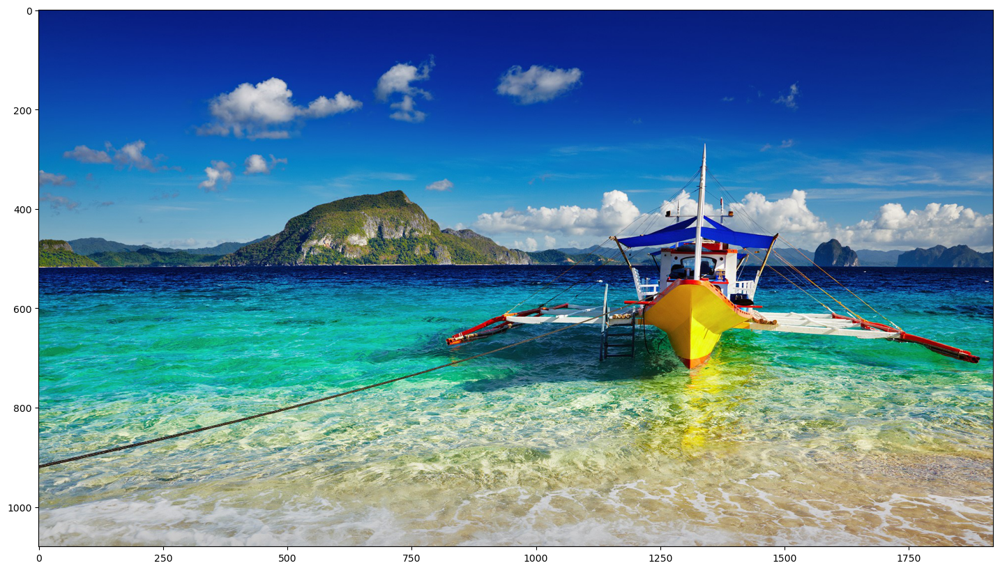

Decoded image by bilinear interpolation


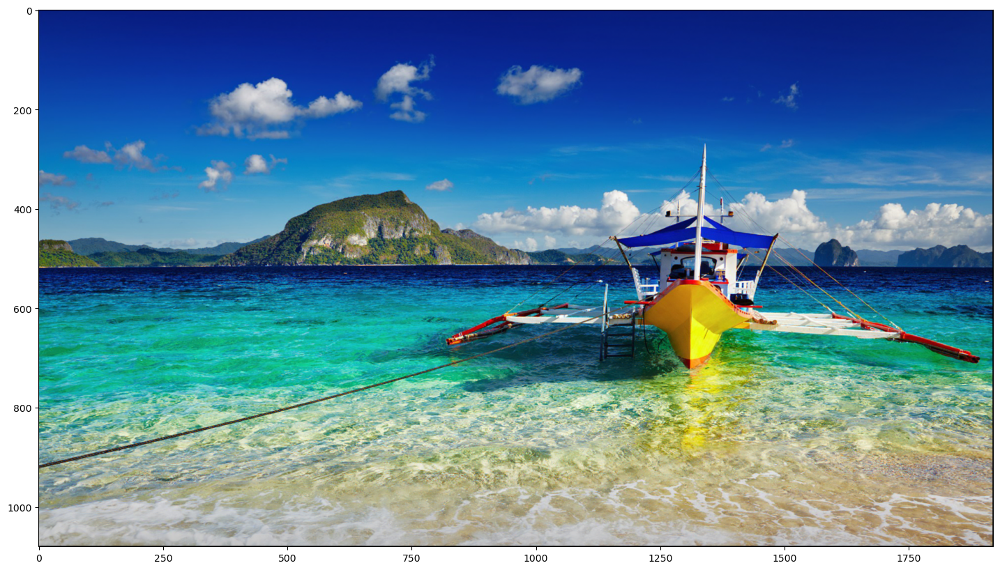

Original image in zoom


<Figure size 2000x1000 with 0 Axes>

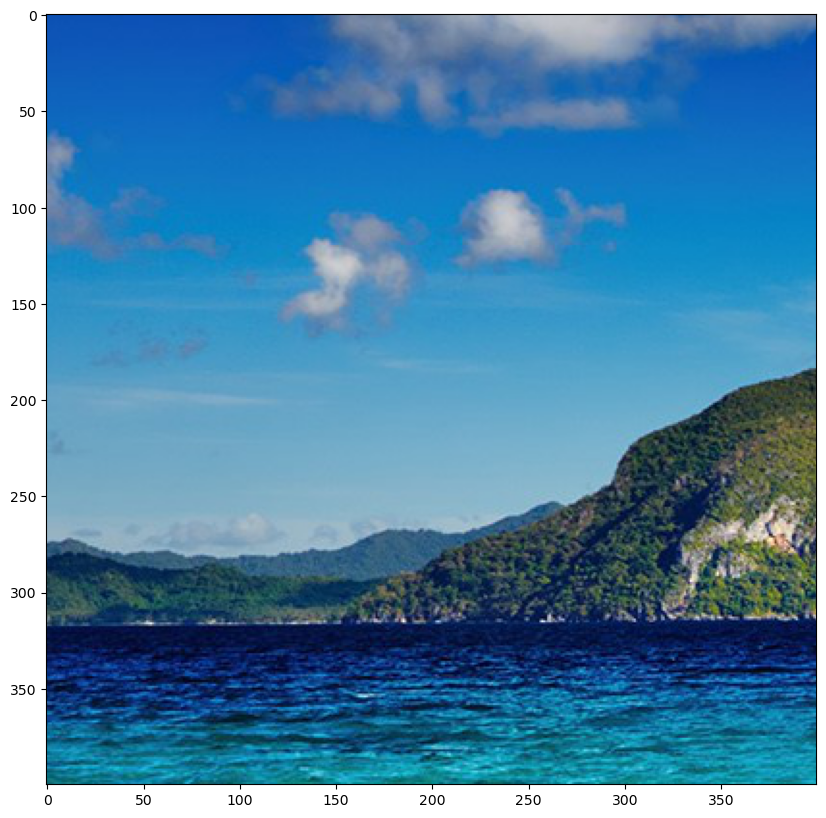

Decoded image by bilinear interpolation in zoom


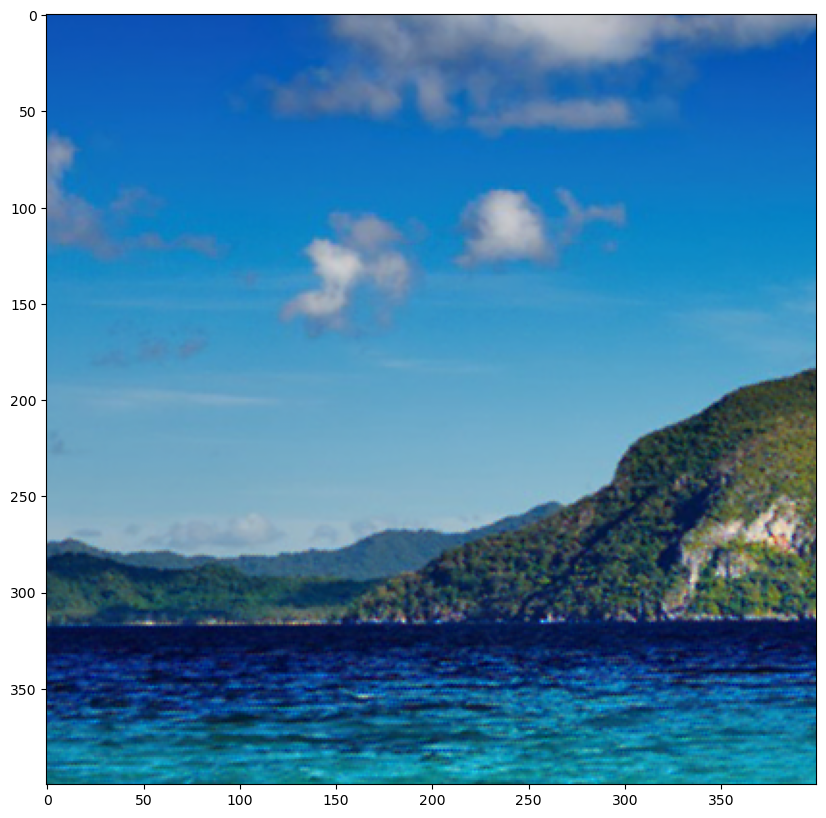

Mean squared error for malvar interpolation: 32010.158074992538
Original image


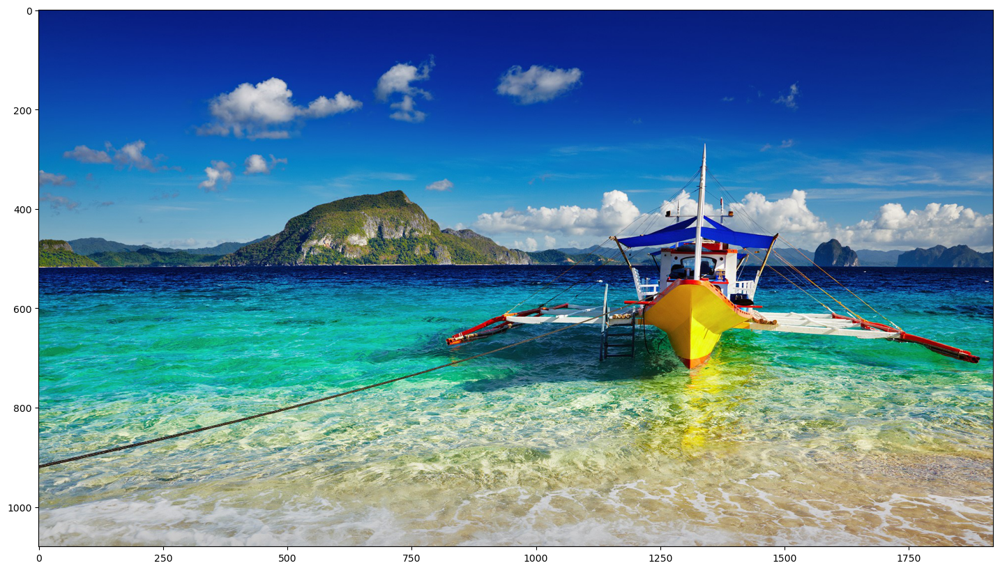

Decoded image by malvar interpolation


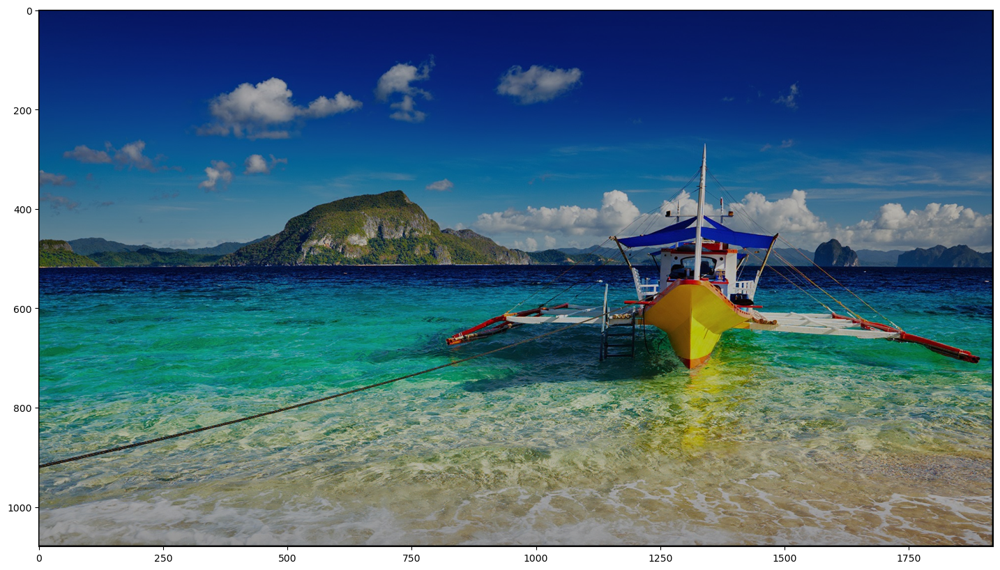

Original image in zoom


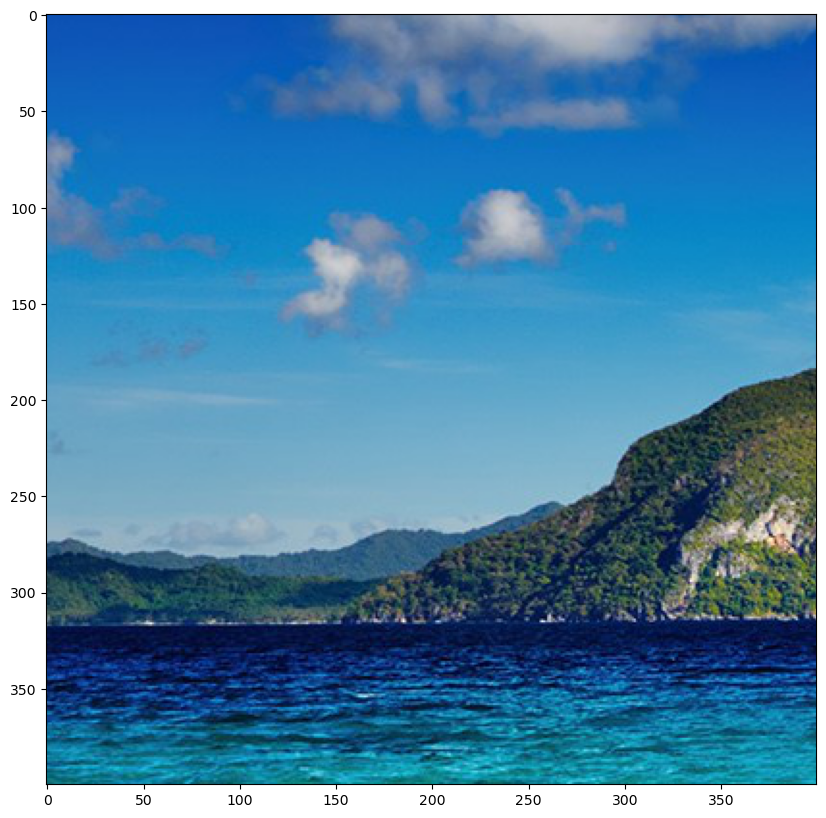

Decoded image by malvar interpolation in zoom


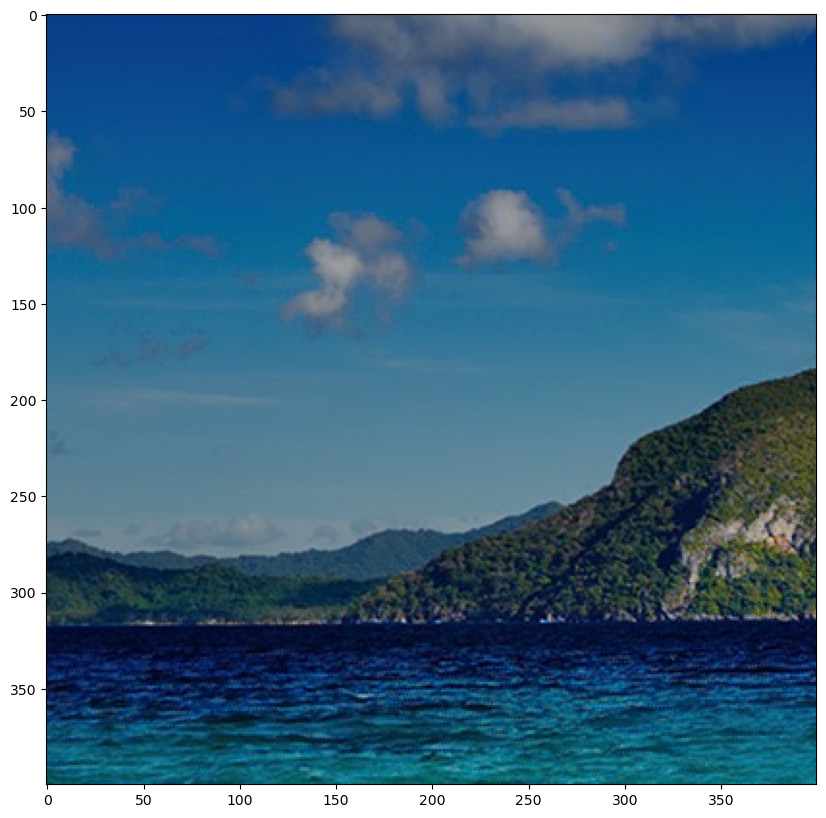

In [8]:
file_paths = [
    f'{IMAGES_DIR}/real1.jpg',
    f'{IMAGES_DIR}/real2.jpg',
    f'{IMAGES_DIR}/real3.jpg',
]

for file_path in file_paths:
    experiment(file_path, False)

Sumarycznie wszystkie wyniki dla błędu średniokwadratowego:
* image1:
    * bilinear interpolation: 5253.81125610869
    * malvar interpolation: 5262.070003895615
* image2:
    * bilinear interpolation: 58116.34631620551
    * malvar interpolation: 58215.9090521347
* image3:
    * bilinear interpolation: 31949.576390123228
    * malvar interpolation: 32010.158074992538

Wnioski:
* Błędy średniokwadratowe są bardzo duże, ale to może wynikać z wad implementacyjnych funkcji odpowiedzialnej za jego liczenie.
* Pomimo, że błędy średniokwardatowe są tak ogromne, to błąd średniokwadratowy dla interpolacji bilinearnej jest mniejszy od interpolacji Malvara. Wynika to z faktu, że przy zastosowaniu algorytmu Malvara zdekodowane obrazy mają większe obramowanie czarnymi pikselami (2 piksele zamiast jednego).
* Obrazy zdekodowane algorytmem interpolacji Malvara są widocznie przyciemnione w stosunku do oryginału. Natomiast wydaje się, że krawędzie są mniej poszarpane. Choć różnicę jest zauważyć bardzo trudno, można spojrzeć na obraz pierwszy. Zdekodowany obraz przy pomocy algorytmu Malvara ma więcej szczegółów niż obraz zdekodowany przy pomocy interpolacji bilinearnej - niebieska opończa energii przy czarodziejce.
* Są fragmenty, z którymi nie radzi sobie żaden z zastosowanych tutaj algorytmów, np. liny na statku w obrazie numer 3. Widoczne są czerwone przebarwienia, sprawiające wrażenie skręcenia tych lin. W oryginalnym obrazie są one proste i nie mają żadnych wcięć.
* Zastosowanie tych algorytmów pokazuje, że zdjęcia wykonywane aparatem nie są w stanie w pełni zarejestrować obrazu rejestrowanego przez ludzkie oko.